In [1]:
import torch
import torchvision
print(torch.__version__) 
print(torchvision.__version__)

2.0.1
0.15.2


In [2]:
import os
os.environ['TORCH_HOME'] = '/data/cmpe249-fa23/torchhome/'
DATAPATH='/data/cmpe249-fa23/torchvisiondata'

https://pytorch.org/vision/stable/models.html#object-detection-instance-segmentation-and-person-keypoint-detection

In [3]:
from torchvision.io.image import read_image
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image

img = read_image("../sampledata/sjsupeople.jpg")

# Step 1: Initialize model with the best available weights
weights = FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT
model = fasterrcnn_resnet50_fpn_v2(weights=weights, box_score_thresh=0.9)
model.eval()

# Step 2: Initialize the inference transforms
preprocess = weights.transforms()

# Step 3: Apply inference preprocessing transforms
batch = [preprocess(img)]

# Step 4: Use the model and visualize the prediction
prediction = model(batch)[0]
labels = [weights.meta["categories"][i] for i in prediction["labels"]]
box = draw_bounding_boxes(img, boxes=prediction["boxes"],
                          labels=labels,
                          colors="red",
                          width=4, font_size=30)
im = to_pil_image(box.detach())
#im.show()

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth
100%|██████████| 167M/167M [00:01<00:00, 116MB/s] 
/home/010796032/miniconda3/envs/mycondapy310/lib/python3.10/site-packages/torchvision/utils.py:232: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


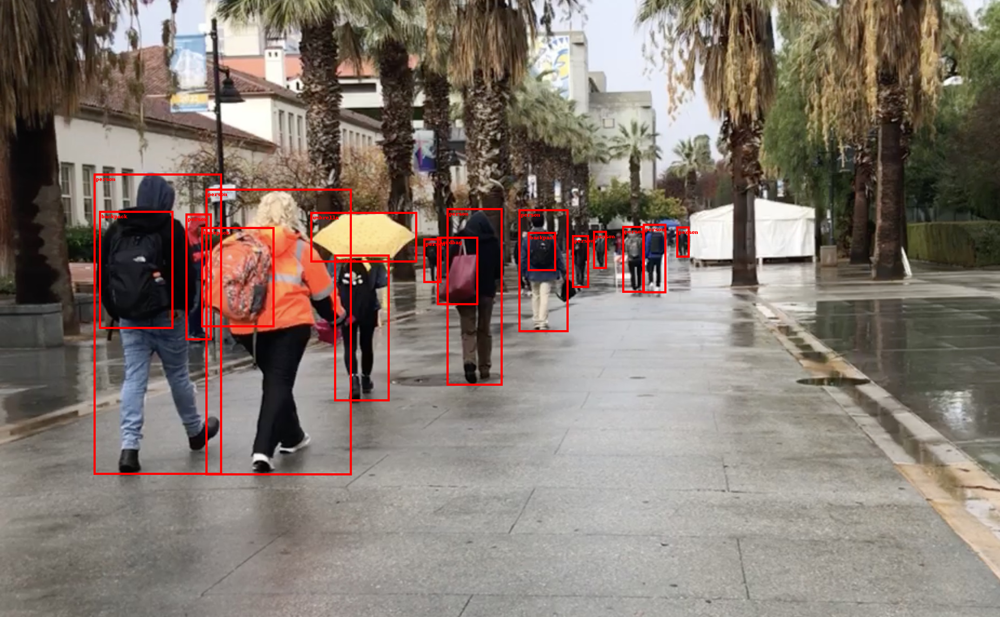

START /usr/bin/chromium-browser "/tmp/tmpcnnxemj6.PNG"


[22713:22754:0916/162958.541478:ERROR:bus.cc(399)] Failed to connect to the bus: Could not parse server address: Unknown address type (examples of valid types are "tcp" and on UNIX "unix")
[22713:22754:0916/162958.541752:ERROR:bus.cc(399)] Failed to connect to the bus: Could not parse server address: Unknown address type (examples of valid types are "tcp" and on UNIX "unix")
[22713:22754:0916/162958.541775:ERROR:bus.cc(399)] Failed to connect to the bus: Could not parse server address: Unknown address type (examples of valid types are "tcp" and on UNIX "unix")
[22713:22754:0916/162958.541817:ERROR:bus.cc(399)] Failed to connect to the bus: Could not parse server address: Unknown address type (examples of valid types are "tcp" and on UNIX "unix")
[22713:22713:0916/162958.588851:ERROR:chrome_browser_cloud_management_controller.cc(163)] Cloud management controller initialization aborted as CBCM is not enabled.
[22713:22754:0916/162958.626308:ERROR:bus.cc(399)] Failed to connect to the bus

In [4]:
im

In [5]:
weights.meta["categories"]

['__background__',
 'person',
 'bicycle',
 'car',
 'motorcycle',
 'airplane',
 'bus',
 'train',
 'truck',
 'boat',
 'traffic light',
 'fire hydrant',
 'N/A',
 'stop sign',
 'parking meter',
 'bench',
 'bird',
 'cat',
 'dog',
 'horse',
 'sheep',
 'cow',
 'elephant',
 'bear',
 'zebra',
 'giraffe',
 'N/A',
 'backpack',
 'umbrella',
 'N/A',
 'N/A',
 'handbag',
 'tie',
 'suitcase',
 'frisbee',
 'skis',
 'snowboard',
 'sports ball',
 'kite',
 'baseball bat',
 'baseball glove',
 'skateboard',
 'surfboard',
 'tennis racket',
 'bottle',
 'N/A',
 'wine glass',
 'cup',
 'fork',
 'knife',
 'spoon',
 'bowl',
 'banana',
 'apple',
 'sandwich',
 'orange',
 'broccoli',
 'carrot',
 'hot dog',
 'pizza',
 'donut',
 'cake',
 'chair',
 'couch',
 'potted plant',
 'bed',
 'N/A',
 'dining table',
 'N/A',
 'N/A',
 'toilet',
 'N/A',
 'tv',
 'laptop',
 'mouse',
 'remote',
 'keyboard',
 'cell phone',
 'microwave',
 'oven',
 'toaster',
 'sink',
 'refrigerator',
 'N/A',
 'book',
 'clock',
 'vase',
 'scissors',
 'ted

In [6]:
len(weights.meta["categories"])

91

In [ ]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights

In [7]:
from torchvision.models import get_model, get_model_weights, get_weight, list_models
pretrained_model=get_model('fasterrcnn_resnet50_fpn_v2', weights="DEFAULT")

In [15]:
pretrained_model=get_model('fasterrcnn_resnet50_fpn_v2', box_score_thresh=0.9, weights="DEFAULT")

In [16]:
pretrained_model.box_score_thresh=0.8

In [17]:
modulelist=list(pretrained_model.named_children())
modulelist

[('transform',
  GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )),
 ('backbone',
  BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (co

In [18]:
lastmodule=modulelist[-1] #get the last Sequential layer
lastmodule

('roi_heads',
 RoIHeads(
   (box_roi_pool): MultiScaleRoIAlign(featmap_names=['0', '1', '2', '3'], output_size=(7, 7), sampling_ratio=2)
   (box_head): FastRCNNConvFCHead(
     (0): Conv2dNormActivation(
       (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
       (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       (2): ReLU(inplace=True)
     )
     (1): Conv2dNormActivation(
       (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
       (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       (2): ReLU(inplace=True)
     )
     (2): Conv2dNormActivation(
       (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
       (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       (2): ReLU(inplace=True)
     )
     (3): Conv2dNormActivation(
       (0): Conv2d(256, 256, ke

In [9]:
all_models = list_models()
detection_models = list_models(module=torchvision.models.detection)
detection_models

['fasterrcnn_mobilenet_v3_large_320_fpn',
 'fasterrcnn_mobilenet_v3_large_fpn',
 'fasterrcnn_resnet50_fpn',
 'fasterrcnn_resnet50_fpn_v2',
 'fcos_resnet50_fpn',
 'keypointrcnn_resnet50_fpn',
 'maskrcnn_resnet50_fpn',
 'maskrcnn_resnet50_fpn_v2',
 'retinanet_resnet50_fpn',
 'retinanet_resnet50_fpn_v2',
 'ssd300_vgg16',
 'ssdlite320_mobilenet_v3_large']

In [20]:

def get_torchvision_detection_models(modelname, box_score_thresh=0.9):
    weights_enum = get_model_weights(modelname) #<enum 'FasterRCNN_MobileNet_V3_Large_320_FPN_Weights'>
    weights = weights_enum.DEFAULT #get the default weights
    preprocess = weights.transforms()
    classes = weights.meta["categories"]
    pretrained_model=get_model(modelname, box_score_thresh=0.9, weights="DEFAULT")
    return pretrained_model, preprocess, weights, classes

In [23]:
from torchvision.io.image import read_image
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image

def test_inference(modelname, imgpath):
    img = read_image(imgpath)
    pretrained_model, preprocess, weights, classes = get_torchvision_detection_models(modelname)
    pretrained_model.eval()
    #Apply inference preprocessing transforms
    batch = [preprocess(img)]
    prediction = pretrained_model(batch)[0]
    labels = [classes[i] for i in prediction["labels"]]
    box = draw_bounding_boxes(img, boxes=prediction["boxes"],
                            labels=labels,
                            colors="red",
                            width=4, font_size=40)
    im = to_pil_image(box.detach())
    return im

In [24]:
imgpath="../sampledata/sjsupeople.jpg"
modelname='fasterrcnn_mobilenet_v3_large_320_fpn'
im = test_inference(modelname, imgpath)

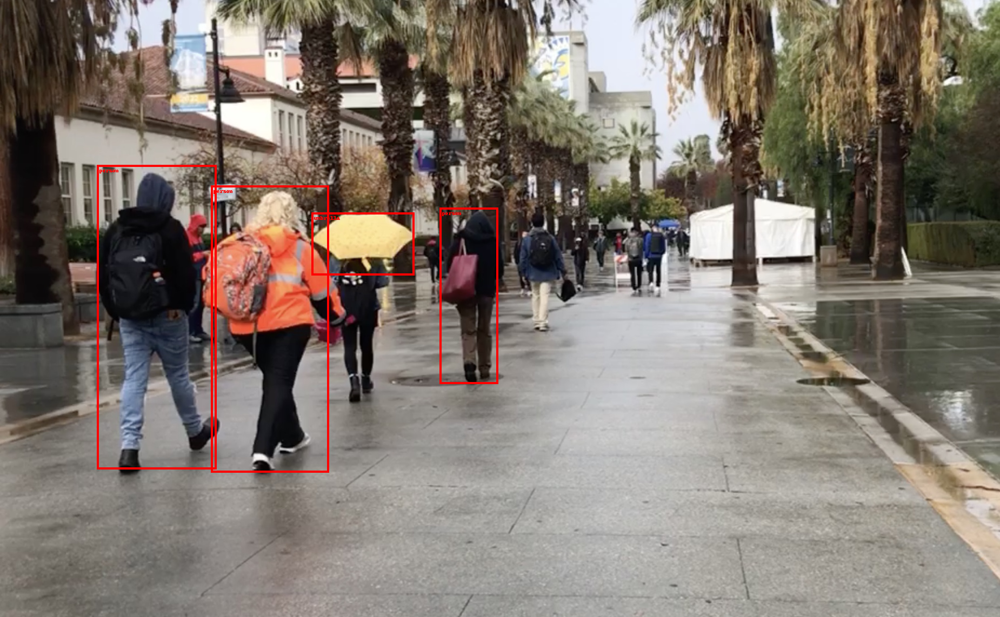

In [25]:
im

Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth
100%|██████████| 74.2M/74.2M [00:00<00:00, 88.4MB/s]
/home/010796032/miniconda3/envs/mycondapy310/lib/python3.10/site-packages/torchvision/utils.py:232: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


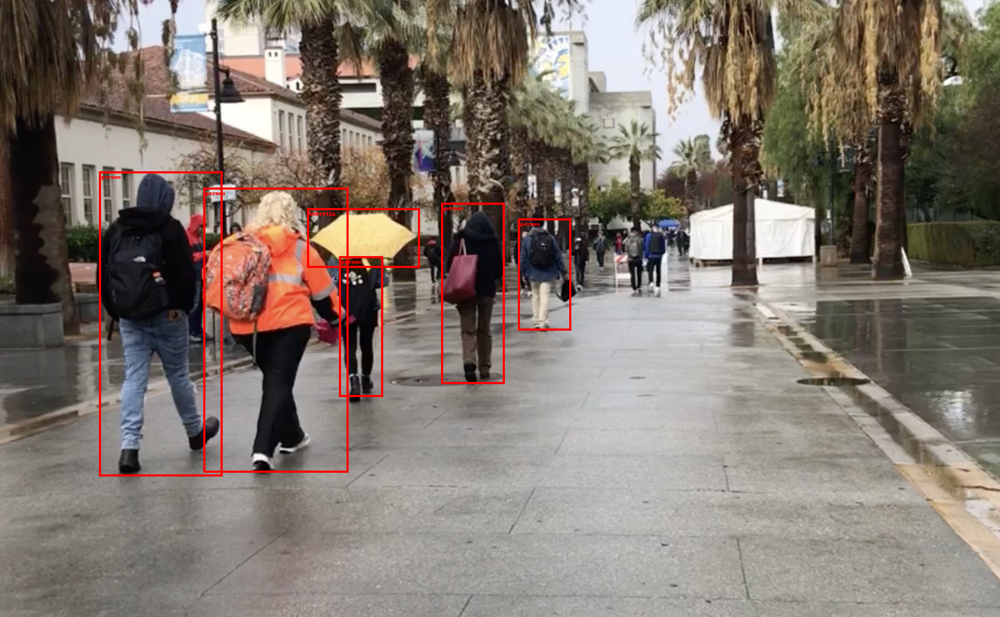

In [26]:
modelname='fasterrcnn_mobilenet_v3_large_fpn'
im = test_inference(modelname, imgpath)
im

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 116MB/s] 


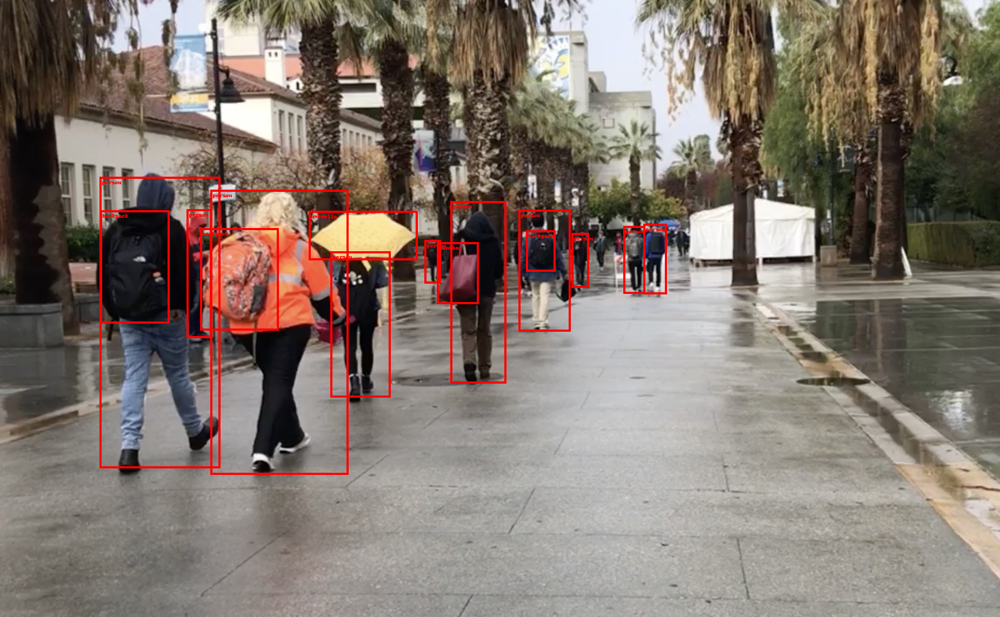

In [27]:
modelname='fasterrcnn_resnet50_fpn'
im = test_inference(modelname, imgpath)
im

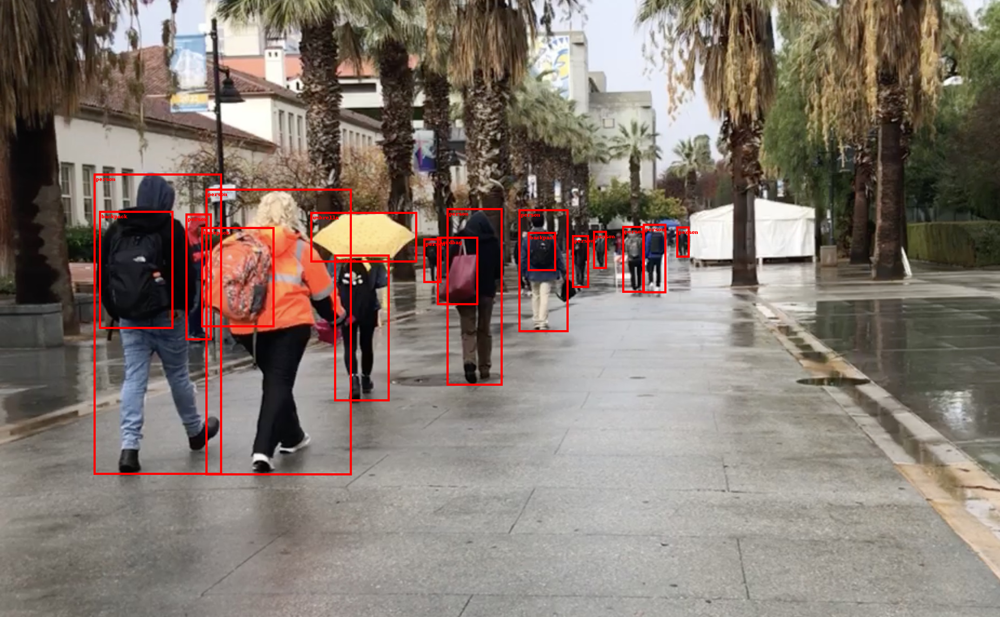

In [28]:
modelname='fasterrcnn_resnet50_fpn_v2'
im = test_inference(modelname, imgpath)
im

Downloading: "https://download.pytorch.org/models/fcos_resnet50_fpn_coco-99b0c9b7.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/fcos_resnet50_fpn_coco-99b0c9b7.pth
100%|██████████| 124M/124M [00:02<00:00, 47.5MB/s] 


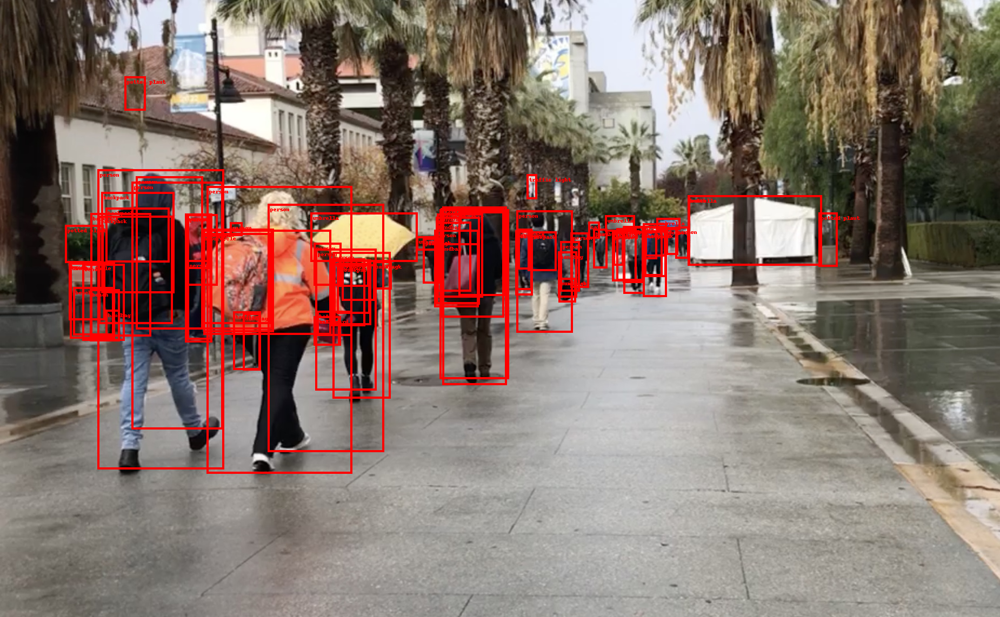

In [29]:
modelname='fcos_resnet50_fpn'
im = test_inference(modelname, imgpath)
im

Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth
100%|██████████| 130M/130M [00:04<00:00, 33.6MB/s] 


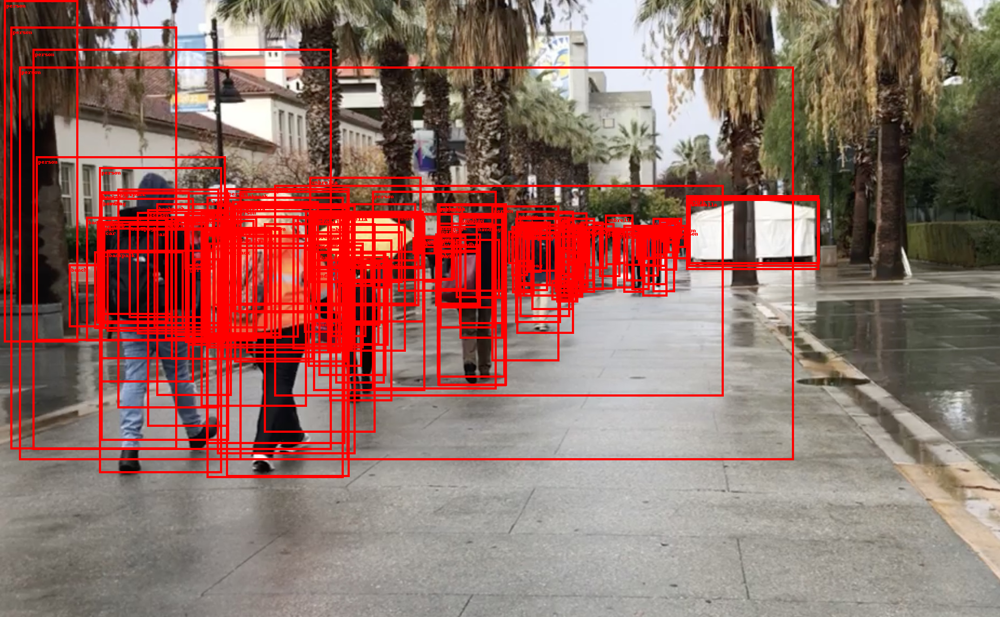

In [30]:
modelname='retinanet_resnet50_fpn'
im = test_inference(modelname, imgpath)
im

Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_v2_coco-5905b1c5.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/retinanet_resnet50_fpn_v2_coco-5905b1c5.pth
100%|██████████| 146M/146M [00:01<00:00, 114MB/s]  


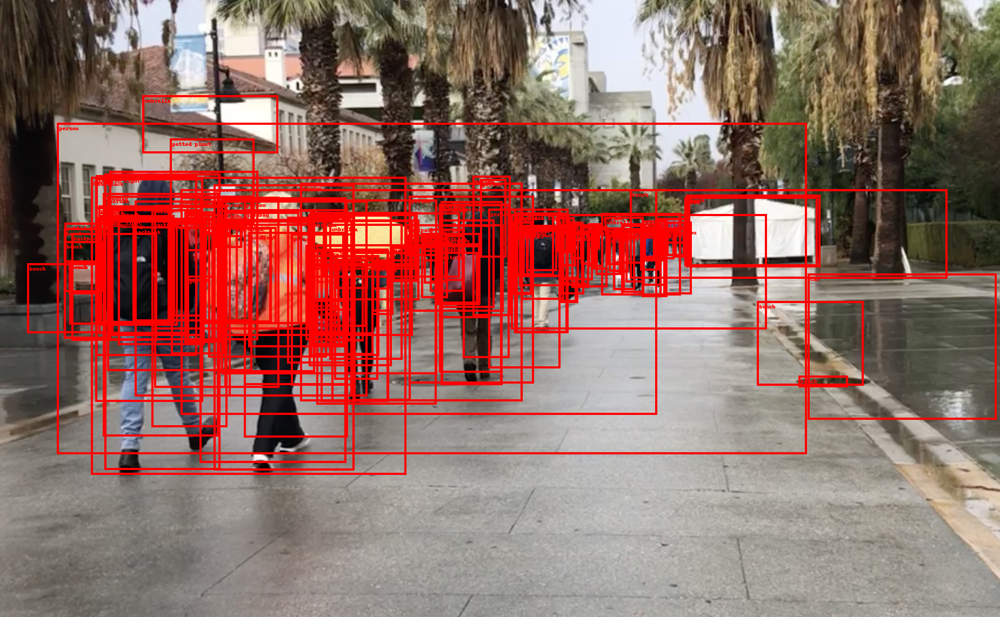

In [31]:
modelname='retinanet_resnet50_fpn_v2'
im = test_inference(modelname, imgpath)
im

Downloading: "https://download.pytorch.org/models/ssd300_vgg16_coco-b556d3b4.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/ssd300_vgg16_coco-b556d3b4.pth
100%|██████████| 136M/136M [00:01<00:00, 96.9MB/s] 


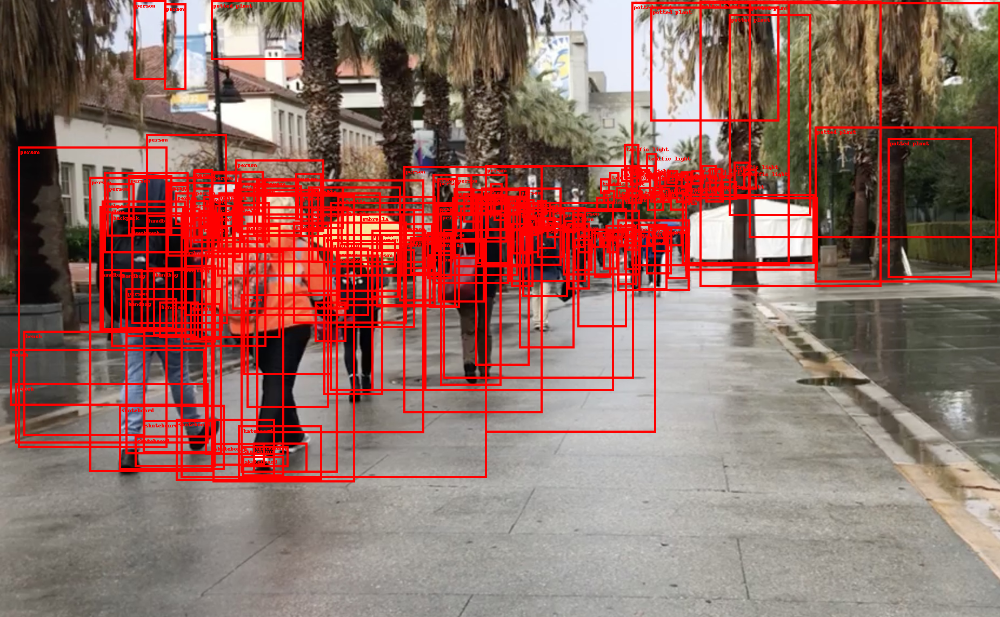

In [32]:
modelname='ssd300_vgg16'
im = test_inference(modelname, imgpath)
im

Downloading: "https://download.pytorch.org/models/ssdlite320_mobilenet_v3_large_coco-a79551df.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/ssdlite320_mobilenet_v3_large_coco-a79551df.pth
100%|██████████| 13.4M/13.4M [00:00<00:00, 111MB/s]


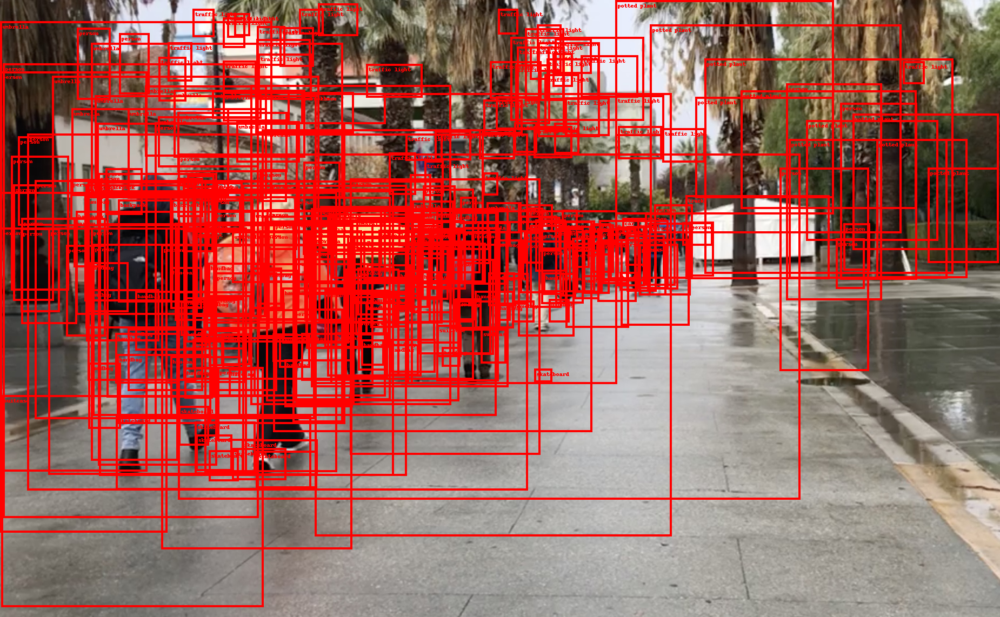

In [33]:
modelname='ssdlite320_mobilenet_v3_large'
im = test_inference(modelname, imgpath)
im

# Segmentation

In [34]:
all_models = list_models()
segmentation_models = list_models(module=torchvision.models.segmentation)
segmentation_models

['deeplabv3_mobilenet_v3_large',
 'deeplabv3_resnet101',
 'deeplabv3_resnet50',
 'fcn_resnet101',
 'fcn_resnet50',
 'lraspp_mobilenet_v3_large']

In [51]:
def test_segmentationinference(modelname, imgpath, showclassmask='person'):
    img = read_image(imgpath)
    pretrained_model, preprocess, weights, classes = get_torchvision_detection_models(modelname)
    pretrained_model.eval()
    #Apply inference preprocessing transforms
    batch = preprocess(img).unsqueeze(0)
    prediction = pretrained_model(batch)["out"] #pretrained_model(batch)[0]
    normalized_masks = prediction.softmax(dim=1)
    class_to_idx = {cls: idx for (idx, cls) in enumerate(classes)}
    mask = normalized_masks[0, class_to_idx[showclassmask]] #class_to_idx["dog"]
    im = to_pil_image(mask)
    return im

In [40]:
img = read_image(imgpath)
pretrained_model, preprocess, weights, classes = get_torchvision_detection_models(modelname)
pretrained_model.eval()
#Apply inference preprocessing transforms
batch = preprocess(img).unsqueeze(0)
prediction = pretrained_model(batch)

In [42]:
prediction = prediction["out"]
prediction.shape

torch.Size([1, 21, 520, 842])

In [43]:
normalized_masks = prediction.softmax(dim=1)
normalized_masks.shape

torch.Size([1, 21, 520, 842])

In [44]:
class_to_idx = {cls: idx for (idx, cls) in enumerate(weights.meta["categories"])}
class_to_idx

{'__background__': 0,
 'aeroplane': 1,
 'bicycle': 2,
 'bird': 3,
 'boat': 4,
 'bottle': 5,
 'bus': 6,
 'car': 7,
 'cat': 8,
 'chair': 9,
 'cow': 10,
 'diningtable': 11,
 'dog': 12,
 'horse': 13,
 'motorbike': 14,
 'person': 15,
 'pottedplant': 16,
 'sheep': 17,
 'sofa': 18,
 'train': 19,
 'tvmonitor': 20}

In [45]:
class_to_idx["person"]

15

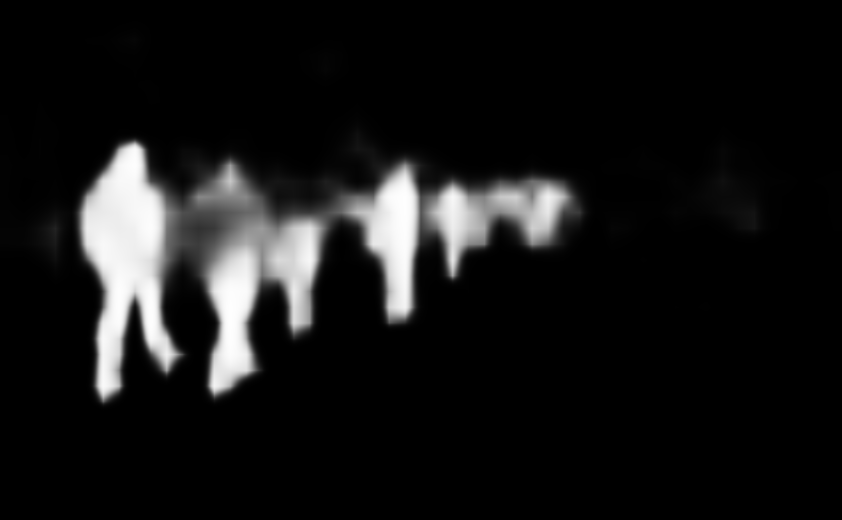

In [46]:
mask = normalized_masks[0, 15]
im=to_pil_image(mask)
im

/home/010796032/miniconda3/envs/mycondapy310/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


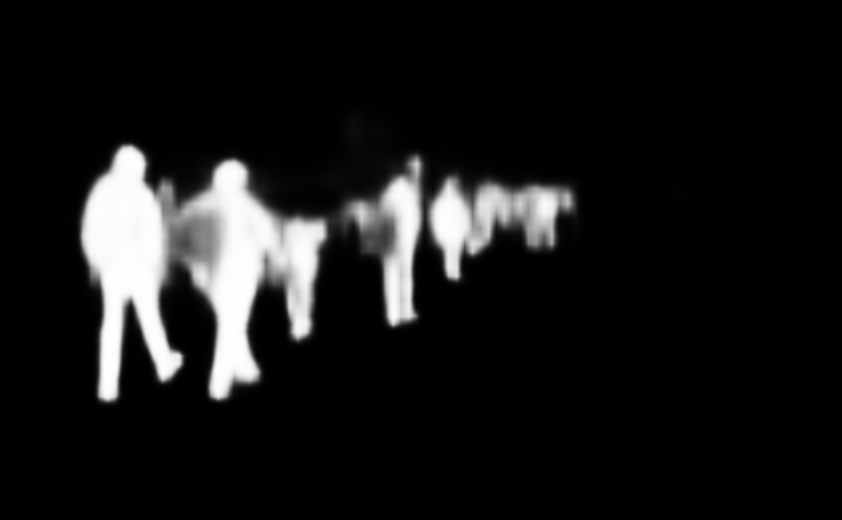

In [52]:
modelname = 'deeplabv3_resnet101' #deeplabv3_resnet101
im = test_segmentationinference(modelname, imgpath, showclassmask='person')
im

Downloading: "https://download.pytorch.org/models/deeplabv3_resnet50_coco-cd0a2569.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/deeplabv3_resnet50_coco-cd0a2569.pth
100%|██████████| 161M/161M [00:01<00:00, 106MB/s]  


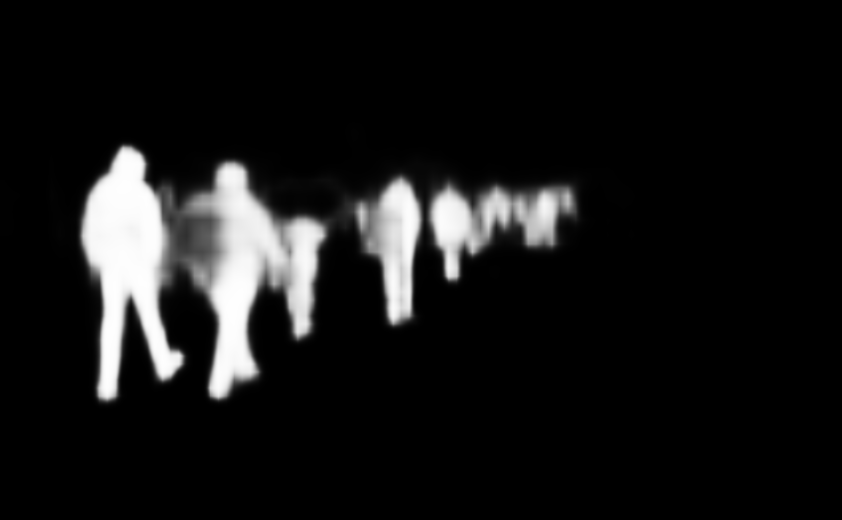

In [53]:
modelname = 'deeplabv3_resnet50'
im = test_segmentationinference(modelname, imgpath, showclassmask='person')
im

Downloading: "https://download.pytorch.org/models/fcn_resnet101_coco-7ecb50ca.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/fcn_resnet101_coco-7ecb50ca.pth
100%|██████████| 208M/208M [00:01<00:00, 110MB/s]  


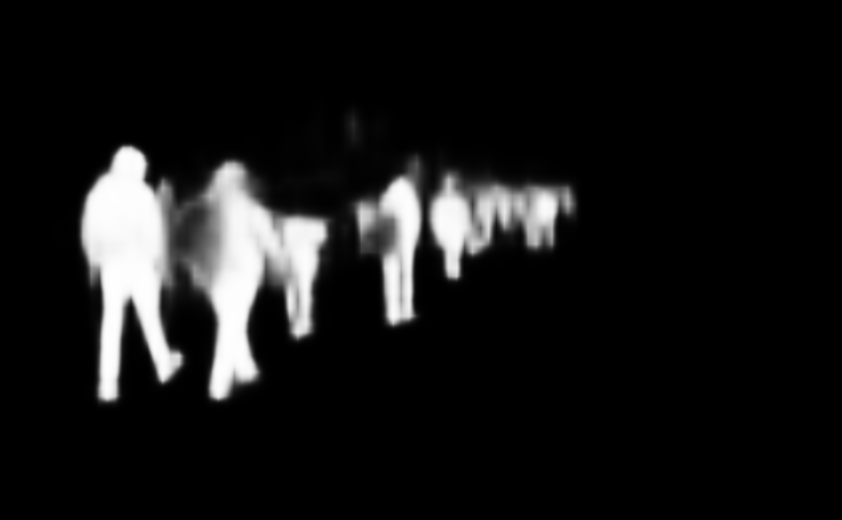

In [54]:
modelname = 'fcn_resnet101'
im = test_segmentationinference(modelname, imgpath, showclassmask='person')
im

Downloading: "https://download.pytorch.org/models/fcn_resnet50_coco-1167a1af.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/fcn_resnet50_coco-1167a1af.pth
100%|██████████| 135M/135M [00:01<00:00, 116MB/s]  


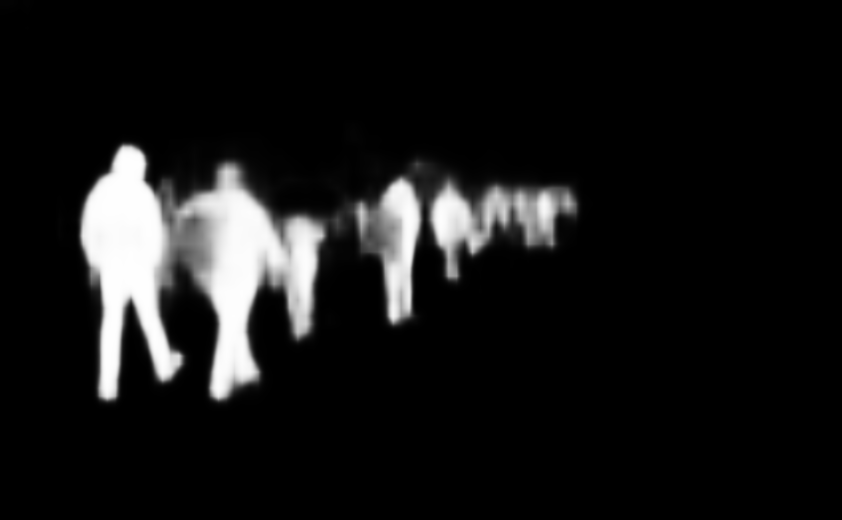

In [55]:
modelname = 'fcn_resnet50'
im = test_segmentationinference(modelname, imgpath, showclassmask='person')
im

Downloading: "https://download.pytorch.org/models/lraspp_mobilenet_v3_large-d234d4ea.pth" to /data/cmpe249-fa23/torchhome/hub/checkpoints/lraspp_mobilenet_v3_large-d234d4ea.pth
100%|██████████| 12.5M/12.5M [00:00<00:00, 109MB/s]


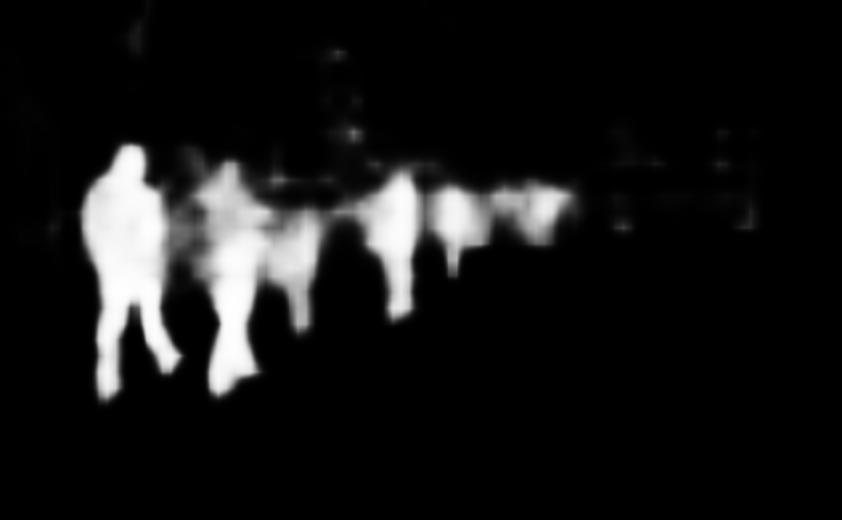

In [56]:
modelname = 'lraspp_mobilenet_v3_large'
im = test_segmentationinference(modelname, imgpath, showclassmask='person')
im

https://pytorch.org/vision/main/generated/torchvision.datasets.Kitti.html

In [57]:
from torch import nn
from torchvision import datasets, transforms
KittiPath='/data/cmpe249-fa23/Kitti'
modelname = 'fasterrcnn_resnet50_fpn_v2'
pretrained_model, preprocess, weights, classes = get_torchvision_detection_models(modelname)
mykitti = datasets.Kitti(root=KittiPath, train= True, transform = preprocess, target_transform = None, download = True)

100%|██████████| 12569945557/12569945557 [21:09<00:00, 9900311.56it/s] 


Extracting /data/cmpe249-fa23/Kitti/Kitti/raw/data_object_image_2.zip to /data/cmpe249-fa23/Kitti/Kitti/raw


100%|██████████| 5601213/5601213 [00:01<00:00, 3777245.47it/s]


Extracting /data/cmpe249-fa23/Kitti/Kitti/raw/data_object_label_2.zip to /data/cmpe249-fa23/Kitti/Kitti/raw


In [58]:
!mv /data/cmpe249-fa23/Kitti/Kitti /data/cmpe249-fa23/torchvisiondata/

In [59]:
!ls /data/cmpe249-fa23/torchvisiondata/

categories_places365.txt	 hymenoptera_data.zip
cifar-10-batches-py		 Kitti
cifar-10-python.tar.gz		 MNIST
FashionMNIST			 places365_test.txt
filelist_places365-standard.tar  places365_train_standard.txt
hymenoptera_data		 places365_val.txt


In [61]:
!ls /data/cmpe249-fa23/torchvisiondata/Kitti/raw

data_object_image_2.zip  data_object_label_2.zip  testing  training


In [63]:
import os

def walk_through_dir(dir_path):
    """
    Walks through dir_path returning its contents.
    Args:
    dir_path (str): target directory

    Returns:
    A print out of:
      number of subdiretories in dir_path
      number of images (files) in each subdirectory
      name of each subdirectory
    """
    for dirpath, dirnames, filenames in os.walk(dir_path):
        print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

In [64]:
kitti_trainpath='/data/cmpe249-fa23/torchvisiondata/Kitti/raw/training'
kitti_testpath='/data/cmpe249-fa23/torchvisiondata/Kitti/raw/testing'
walk_through_dir(kitti_trainpath)

There are 2 directories and 0 images in '/data/cmpe249-fa23/torchvisiondata/Kitti/raw/training'.
There are 0 directories and 7481 images in '/data/cmpe249-fa23/torchvisiondata/Kitti/raw/training/image_2'.
There are 0 directories and 7481 images in '/data/cmpe249-fa23/torchvisiondata/Kitti/raw/training/label_2'.


In [65]:
walk_through_dir(kitti_testpath)

There are 1 directories and 0 images in '/data/cmpe249-fa23/torchvisiondata/Kitti/raw/testing'.
There are 0 directories and 7518 images in '/data/cmpe249-fa23/torchvisiondata/Kitti/raw/testing/image_2'.


COCO dataset: https://pytorch.org/vision/main/generated/torchvision.datasets.CocoDetection.html#torchvision.datasets.CocoDetection

In [68]:
#conda install -c conda-forge pycocotools

done
Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.14.0
  latest version: 23.7.4

Please update conda by running

    $ conda update -n base -c defaults conda



## Package Plan ##

  environment location: /home/010796032/miniconda3/envs/mycondapy310

  added / updated specs:
    - pycocotools


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    cython-3.0.2               |  py310hc6cd4ac_0         3.1 MB  conda-forge
    openssl-1.1.1w             |       hd590300_0         1.9 MB  conda-forge
    pycocotools-2.0.6          |  py310hde88566_1         106 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         5.0 MB

The following NEW packages will be INSTALLED:

  cython             conda-forge/linux-64::cython-3.0.2-py310hc6cd4ac_0
  pycocotools        c

In [2]:
from torch import nn
from torchvision import datasets, transforms
rootPath='/data/cmpe249-fa23/COCOoriginal/train2017'
cocoannatationfile='/data/cmpe249-fa23/COCOoriginal/annotations/instances_train2017.json'
mycoco_train = datasets.CocoDetection(root=rootPath, annFile=cocoannatationfile, transform = None)

loading annotations into memory...
Done (t=16.46s)
creating index...
index created!


In [3]:
mycoco_train

Dataset CocoDetection
    Number of datapoints: 118287
    Root location: /data/cmpe249-fa23/COCOoriginal/train2017